<a href="https://colab.research.google.com/github/omerbokobza/DeepSuperResolution/blob/main/Transformer_L1_perfect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch.nn as nn
from torch import nn, optim
from torchvision import transforms
from torch.utils.data import Dataset
import random
import torch.nn.functional as F
!pip install kornia
import kornia
import torchvision.transforms as T

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 833.3/833.3 kB 42.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 80.1 MB/s eta 0:00:00


/usr/local/lib/python3.10/dist-packages/kornia/feature/lightglue.py:44: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  @torch.cuda.amp.custom_fwd(cast_inputs=torch.float32)


In [ ]:
import torchvision.models as models

# Drive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


# **Downloading the data**

In [ ]:
!mkdir DIV2K
!wget -O DIV2K/DIV2K_train_HR.zip http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
!unzip DIV2K/DIV2K_train_HR.zip -d DIV2K

--2024-08-29 23:27:56--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip [following]
--2024-08-29 23:27:56--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3530603713 (3.3G) [application/zip]
Saving to: ‘DIV2K/DIV2K_train_HR.zip’

DIV2K/DIV2K_train_H 100%[===================>]   3.29G  21.9MB/s    in 2m 34s  

2024-08-29 23:30:31 (21.8 MB/s) - ‘DIV2K/DIV2K_train_HR.zip’ saved [3530603713/3530603713]

Archive:  DIV2K/DIV2K_train_HR.zip
   creating: DIV2K/DIV2K_train_HR/
  inflating: DIV2K/DIV2K_train_HR/

In [ ]:
!wget -O DIV2K/DIV2K_valid_HR.zip http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
!unzip DIV2K/DIV2K_valid_HR.zip -d DIV2K

--2024-08-29 23:31:05--  http://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Resolving data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)... 129.132.52.178, 2001:67c:10ec:36c2::178
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip [following]
--2024-08-29 23:31:06--  https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip
Connecting to data.vision.ee.ethz.ch (data.vision.ee.ethz.ch)|129.132.52.178|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 448993893 (428M) [application/zip]
Saving to: ‘DIV2K/DIV2K_valid_HR.zip’

DIV2K/DIV2K_valid_H 100%[===================>] 428.19M  21.8MB/s    in 21s     

2024-08-29 23:31:27 (20.6 MB/s) - ‘DIV2K/DIV2K_valid_HR.zip’ saved [448993893/448993893]

Archive:  DIV2K/DIV2K_valid_HR.zip
   creating: DIV2K/DIV2K_valid_HR/
  inflating: DIV2K/DIV2K_valid_HR/089

In [ ]:
# List files in the DIV2K_train_HR directories
hr_dir = 'DIV2K/DIV2K_train_HR/'
print(os.listdir(hr_dir)[:10])  # Show the first 10 files

['0391.png', '0011.png', '0144.png', '0643.png', '0039.png', '0361.png', '0694.png', '0163.png', '0775.png', '0130.png']


In [ ]:
# Set up paths for training and validation directories
train_hr_dir = 'DIV2K/DIV2K_train_HR/'
valid_hr_dir = 'DIV2K/DIV2K_valid_HR/'

#splitting & visualize the data

In [ ]:
train_images = os.listdir(train_hr_dir)
val_images = os.listdir(valid_hr_dir)
print(f'Train Before Splitting: {len(train_images)}')

test_images = random.sample(train_images, 100)
train_images = [img for img in train_images if img not in test_images]

print(f'Train After Split: {len(train_images)}, Test: {len(test_images)}, Validation: {len(val_images)}')

Train Before Splitting: 800
Train After Split: 700, Test: 100, Validation: 100


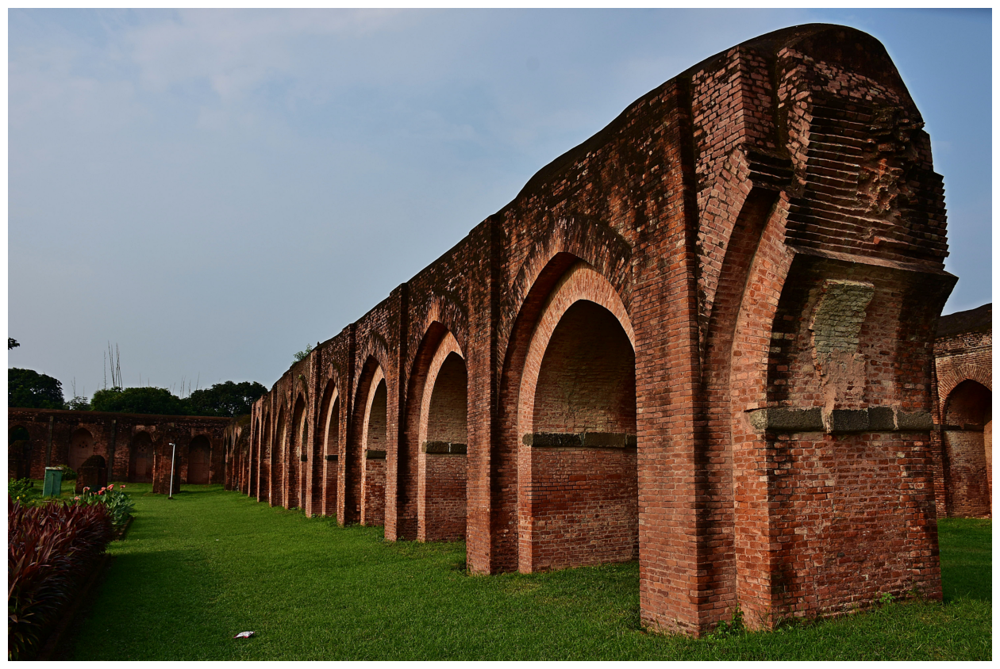

In [ ]:
# Load an example image
example_image_path = os.path.join(hr_dir, '0283.png')  # Change the filename as needed
image = Image.open(example_image_path)

# Display the image
plt.figure(figsize=(16, 16))
plt.imshow(image)
plt.axis('off')  # Hide axis labels
plt.show()

In [ ]:
print(image.size)

NameError: name 'image' is not defined

In [ ]:
class DIV2KDataset(Dataset):
    def __init__(self, image_list, hr_dir, crop_size=(256, 256), scale_factor=4, transform=None):
        super(DIV2KDataset, self).__init__()
        self.image_list = image_list
        self.hr_dir = hr_dir
        self.crop_size = crop_size
        self.scale_factor = scale_factor
        self.transform = transform

    def __len__(self):
        return len(self.image_list)

    def __getitem__(self, idx):
        # Load the high-resolution image
        image_path = os.path.join(self.hr_dir, self.image_list[idx])
        image = Image.open(image_path).convert('RGB')

        if image.size[0] < image.size[1]:
            image = image.rotate(-90, expand=True)

        # Random crop to the crop_size (e.g., 256x256)
        hr_image = transforms.RandomCrop(self.crop_size)(image)

        # Resize HR image to low-resolution (e.g., 64x64)
        lr_image = hr_image.resize((self.crop_size[0] // self.scale_factor, self.crop_size[1] // self.scale_factor), Image.BICUBIC)

        # Apply transformations
        hr_image = self.transform(hr_image)
        lr_image = self.transform(lr_image)

        return lr_image, hr_image

In [ ]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])
# Create datasets
crop_size = (256, 256)
scale_factor = 4

train_dataset = DIV2KDataset(train_images, train_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)
valid_dataset = DIV2KDataset(os.listdir(valid_hr_dir), valid_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)
test_dataset = DIV2KDataset(test_images, train_hr_dir, crop_size=crop_size, scale_factor=scale_factor, transform=transform)

# Create DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
valid_loader = DataLoader(valid_dataset, batch_size=16, shuffle=False, num_workers=4)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False, num_workers=4)


In [ ]:
for lr_imgs, hr_imgs in train_loader:
    print(f"Low-resolution images batch shape: {lr_imgs.shape}")
    print(f"High-resolution images batch shape: {hr_imgs.shape}")
    break


Low-resolution images batch shape: torch.Size([16, 3, 64, 64])
High-resolution images batch shape: torch.Size([16, 3, 256, 256])


Low-resolution image size: (64, 64)
High-resolution image size: (256, 256)


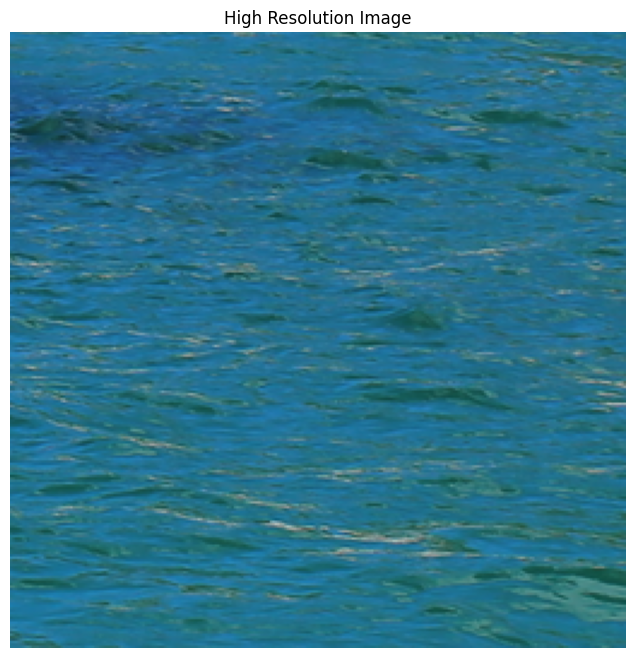

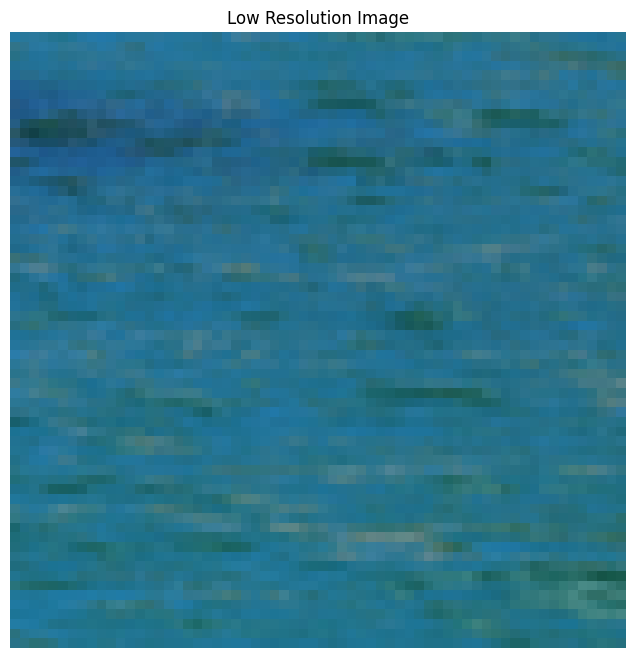

In [ ]:
# Define the inverse normalization transformation
inverse_transform = transforms.Compose([
    transforms.Normalize((-1, -1, -1), (2, 2, 2)),  # Undo the normalization
    transforms.ToPILImage()  # Convert back to a PIL image
])

# Assuming lr_image and hr_image are from the DataLoader
for lr_images, hr_images in train_loader:
    # Take the first image from the batch
    lr_image = lr_images[0]
    hr_image = hr_images[0]
    #
    # Un-normalize and convert to PIL image
    lr_image_pil = inverse_transform(lr_image)
    hr_image_pil = inverse_transform(hr_image)

    # Display the images
    print(f"Low-resolution image size: {lr_image_pil.size}")
    print(f"High-resolution image size: {hr_image_pil.size}")

    plt.figure(figsize=(8, 8))
    plt.title("High Resolution Image")
    plt.imshow(hr_image_pil)
    plt.axis('off')
    plt.show()

    plt.figure(figsize=(8, 8))
    plt.title("Low Resolution Image")
    plt.imshow(lr_image_pil)
    plt.axis('off')
    plt.show()

    break  # Display only the first batch


# Transformer Model for Super-Resolution


## Explanation


The model aims to upscale low-resolution images to high-resolution images while preserving details and texture.
Architecture:

###**Encoder:**
 The encoder transforms the low-resolution image into a compact latent representation by learning important features from the image. It uses several layers of Transformer encoders that capture both local and global dependencies within the image.

###**Positional Encoding:**
 Since Transformers don’t inherently understand the spatial structure of images, positional encoding is added to the input to provide information about the position of each pixel in the image.

###**Decoder:**
 The decoder takes the latent representation from the encoder and reconstructs the high-resolution image. It uses Transformer decoder layers to learn how to expand and refine the image details, ensuring that the output is a high-resolution version of the input.

Final Convolution Layer: After decoding, a convolutional layer is applied to map the processed features back to an image format, producing the final high-resolution output.

###**Advantages:**

Global Context:

Transformers are particularly good at capturing long-range dependencies, making them effective at understanding the overall structure and fine details of an image.
Flexibility: The encoder-decoder structure is versatile and can be adjusted by changing the number of layers, heads, and other parameters to fit the specific requirements of the task.

###**Training:**

The model can be trained using a combination of loss functions such as MSE, MAE, perceptual loss, and color consistency loss to ensure that the output image is both accurate and visually pleasing.

###**Summary:**
This Transformer-based encoder-decoder model provides a modern approach to super-resolution, leveraging the power of Transformers to handle the complex task of upscaling images while maintaining high-quality details and textures.

## Model-Code

In [ ]:

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_len=5000):
        super(PositionalEncoding, self).__init__()
        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-torch.log(torch.tensor(10000.0)) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0), :]
        return x

class TransformerEncoderDecoder(nn.Module):
    def __init__(self, img_dim, num_layers=6, nhead=8, dim_feedforward=2048, dropout=0.3):
        super(TransformerEncoderDecoder, self).__init__()
        self.img_dim = img_dim

        # Project input channels to the desired dimension (img_dim)
        self.input_proj = nn.Conv2d(3, img_dim, kernel_size=1)  # 1x1 Conv to adjust channels

        # Positional Encoding
        self.pos_encoder = PositionalEncoding(d_model=img_dim)

        # Transformer Encoder
        self.encoder_layer = nn.TransformerEncoderLayer(d_model=img_dim, nhead=nhead, dim_feedforward=dim_feedforward, dropout=dropout)
        self.encoder = nn.TransformerEncoder(self.encoder_layer, num_layers=num_layers)

        # Transformer Decoder
        self.decoder_layer = nn.TransformerDecoderLayer(d_model=img_dim, nhead=nhead, dim_feedforward=dim_feedforward, dropout=dropout)
        self.decoder = nn.TransformerDecoder(self.decoder_layer, num_layers=num_layers)

        # Upsampling layer to increase spatial resolution
        self.upsample = nn.Upsample(scale_factor=4, mode='bilinear', align_corners=True)  # From 64x64 to 256x256

        # Final Convolution to output the image
        self.final_conv = nn.Conv2d(img_dim, 3, kernel_size=3, padding=1)

    def forward(self, x):
        batch_size, _, height, width = x.size()

        # Project the input to the embedding dimension
        x = self.input_proj(x)  # (batch_size, img_dim, H, W)

        # Flatten and project to higher dimension (embedding)
        x = x.flatten(2).permute(2, 0, 1)  # (H*W, batch_size, img_dim)
        x = self.pos_encoder(x)  # Apply positional encoding

        # Encode
        encoded = self.encoder(x)

        # Decode
        decoded = self.decoder(encoded, encoded)

        # Reshape and upsample to the desired output size
        decoded = decoded.permute(1, 2, 0).view(batch_size, self.img_dim, height, width)
        upsampled = self.upsample(decoded)

        # Output final high-resolution image
        out = self.final_conv(upsampled)

        return out


# Example instantiation
# img_dim = 64  # This should match the flattened dimension of the image (H*W)
# model = TransformerEncoderDecoder(img_dim=img_dim)

# # Testing the model with an input tensor of size (batch_size=1, channels=3, height=64, width=64)
# input_tensor = torch.rand(1, 3, 64, 64)  # Create a random input tensor
# output_tensor = model(input_tensor)  # Forward pass
# print(f"Input size: {input_tensor.shape}, Output size: {output_tensor.shape}")

In [ ]:
def save_checkpoint(model, epoch, val_loss, name_for_checkpoints, checkpoint_dir):
    os.makedirs(checkpoint_dir, exist_ok=True)
    checkpoint_filename = f'{name_for_checkpoints}_epoch_{epoch+1}_val_loss_{val_loss:.4f}.pth'
    checkpoint_path = os.path.join(checkpoint_dir, checkpoint_filename)
    torch.save(model.state_dict(), checkpoint_path)
    print(f"Checkpoint saved: {checkpoint_path}")

In [ ]:
torch.cuda.empty_cache()

In [ ]:
def train_transformer(model, train_loader, valid_loader, criterion, perceptual_criterion, optimizer, num_epochs=20, device='cuda', name_for_checkpoints=None, checkpoint_dir='/content/gdrive/My Drive/Colab Notebooks/checkpoints'):
    model = model.to(device)
    best_val_loss = float('inf')

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        print(f'Epoch {epoch+1}/{num_epochs}...')

        # Training Phase
        model.train()
        train_loss = 0.0

        for lr_imgs, hr_imgs in train_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            optimizer.zero_grad()

            # Generate high-resolution images from low-resolution images
            fake_hr_imgs = model(lr_imgs)

            # Content loss (e.g., MSE or MAE between generated and real HR images)
            loss = criterion(fake_hr_imgs, hr_imgs)

            # Optionally add perceptual loss
            if perceptual_criterion is not None:
                perceptual_loss = perceptual_criterion(fake_hr_imgs, hr_imgs)
                loss = loss + 0.01 * perceptual_loss

            train_loss += loss.item()

            loss.backward()
            optimizer.step()

        avg_train_loss = train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {avg_train_loss:.4f}')

        # Validation Phase
        model.eval()
        with torch.no_grad():
            val_loss = 0.0
            for lr_imgs, hr_imgs in valid_loader:
                lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
                fake_hr_imgs = model(lr_imgs)
                val_loss += criterion(fake_hr_imgs, hr_imgs).item()

        avg_val_loss = val_loss / len(valid_loader)
        val_losses.append(avg_val_loss)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {avg_val_loss:.4f}")

        # Save checkpoint every 4 epochs and at the first epoch
        if (epoch + 1) % 4 == 0 or epoch == 0:
            save_checkpoint(model, epoch, avg_val_loss, name_for_checkpoints, checkpoint_dir)

        torch.cuda.empty_cache()

    # Plot training and validation loss
    plt.figure()
    plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss')
    plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Validation Loss Over Epochs')
    plt.legend()
    plt.show()
    plt.savefig(f'/content/gdrive/My Drive/Colab Notebooks/figs/{name_for_checkpoints}_loss.pdf', bbox_inches='tight')

    return model

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


#**LOSS = MAE= $\sum{|y_{out}-y_{in}|}$**

In [ ]:
class CombinedMSEMAELoss(nn.Module):
    def __init__(self, alpha=0.5):
        """
        Combined MSE and MAE loss function.

        Args:
        - alpha (float): Regularization factor for the MAE term. Controls the influence of the MAE on the total loss.
        """
        super(CombinedMSEMAELoss, self).__init__()
        self.mse = nn.MSELoss()
        self.mae = nn.L1Loss()
        self.alpha = alpha

    def forward(self, output, target):
        mse_loss = self.mse(output, target)
        mae_loss = self.mae(output, target)
        combined_loss = self.alpha * mae_loss #0*mse_loss + self.alpha * mae_loss
        return combined_loss

# class PerceptualLoss(nn.Module):
#     def __init__(self, pretrained_model, device):
#         super(PerceptualLoss, self).__init__()
#         self.feature_extractor = nn.Sequential(*list(pretrained_model.features)[:16]).eval()  # Example: VGG layers till conv4_3
#         self.feature_extractor = self.feature_extractor.to(device)

#     def forward(self, output, target):
#         output_features = self.feature_extractor(output)
#         target_features = self.feature_extractor(target)
#         loss = F.mse_loss(output_features, target_features)
#         return loss
# vgg16 = models.vgg16(pretrained=True).to(device)

Epoch 1/20...
Epoch [1/20], Train Loss: 0.7555
Epoch [1/20], Validation Loss: 0.6160
Checkpoint saved: /content/gdrive/My Drive/Colab Notebooks/checkpoints/transformer_sr_enc_dec_MAE_epoch_1_val_loss_0.6160.pth
Epoch 2/20...
Epoch [2/20], Train Loss: 0.5268
Epoch [2/20], Validation Loss: 0.3304
Epoch 3/20...
Epoch [3/20], Train Loss: 0.3724
Epoch [3/20], Validation Loss: 0.2865
Epoch 4/20...
Epoch [4/20], Train Loss: 0.3361
Epoch [4/20], Validation Loss: 0.2844
Checkpoint saved: /content/gdrive/My Drive/Colab Notebooks/checkpoints/transformer_sr_enc_dec_MAE_epoch_4_val_loss_0.2844.pth
Epoch 5/20...
Epoch [5/20], Train Loss: 0.3208
Epoch [5/20], Validation Loss: 0.2670
Epoch 6/20...
Epoch [6/20], Train Loss: 0.3022
Epoch [6/20], Validation Loss: 0.2469
Epoch 7/20...
Epoch [7/20], Train Loss: 0.2919
Epoch [7/20], Validation Loss: 0.2470
Epoch 8/20...
Epoch [8/20], Train Loss: 0.2887
Epoch [8/20], Validation Loss: 0.2527
Checkpoint saved: /content/gdrive/My Drive/Colab Notebooks/checkpoin

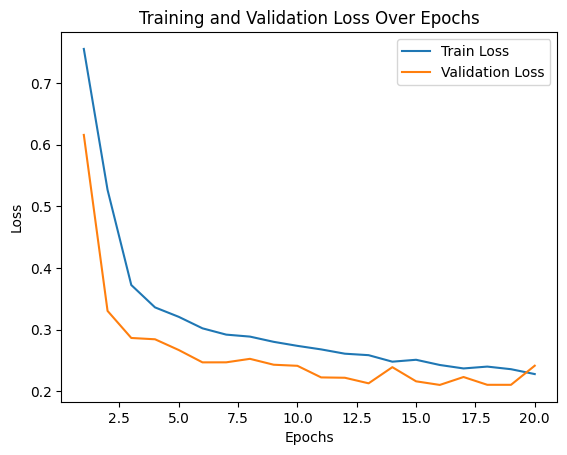

<Figure size 640x480 with 0 Axes>

In [ ]:
# Instantiate the model, loss function, and optimizer
name_for_checkpoints = 'transformer_sr_enc_dec_MAE'
model = TransformerEncoderDecoder(img_dim=64)  # Adjust img_dim as needed
criterion = CombinedMSEMAELoss(alpha=2)  # You can experiment with the alpha value


optimizer = optim.Adam(model.parameters(), lr=1e-4)

# Assuming train_loader and valid_loader are defined
trained_model = train_transformer(
    model=model,
    train_loader=train_loader,
    valid_loader=valid_loader,
    criterion=criterion,
    perceptual_criterion=None,
    optimizer=optimizer,
    num_epochs=20,
    device=device,
    name_for_checkpoints=name_for_checkpoints
)

# Evaluation

In [ ]:
def calculate_psnr(output, target):
    mse = F.mse_loss(output, target)
    psnr = 10 * torch.log10(1 / mse)  # assuming images are normalized between [0, 1]
    return psnr.item()

In [ ]:
def calculate_ssim(output, target):
    # SSIM expects images to be in range [0, 1]
    output = output.clamp(0, 1)
    target = target.clamp(0, 1)

    # Calculate SSIM
    ssim_value = kornia.metrics.ssim(output, target, window_size=11).mean()
    return ssim_value.item()

def gaussian(window_size, sigma, device):
    gauss = torch.tensor([torch.exp(torch.tensor(-(x - window_size//2)**2 / float(2*sigma**2))) for x in range(window_size)], device=device)
    return gauss / gauss.sum()

def create_window(window_size, channel, device):
    _1D_window = gaussian(window_size, 1.5, device).unsqueeze(1)
    _2D_window = _1D_window.mm(_1D_window.t()).float().unsqueeze(0).unsqueeze(0)
    window = _2D_window.expand(channel, 1, window_size, window_size).contiguous()
    return window


def _ssim(img1, img2, window, window_size, channel, size_average=True):
    mu1 = F.conv2d(img1, window, padding=window_size//2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size//2, groups=channel)

    mu1_sq = mu1.pow(2)
    mu2_sq = mu2.pow(2)
    mu1_mu2 = mu1 * mu2

    sigma1_sq = F.conv2d(img1 * img1, window, padding=window_size//2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2 * img2, window, padding=window_size//2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1 * img2, window, padding=window_size//2, groups=channel) - mu1_mu2

    C1 = 0.01 ** 2
    C2 = 0.03 ** 2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2))

    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map.mean(1).mean(1).mean(1)

def ssim(img1, img2, window_size=11, size_average=True):
    (_, channel, _, _) = img1.size()
    device = img1.device
    window = create_window(window_size, channel, device)

    return _ssim(img1, img2, window, window_size, channel, size_average)

def msssim(img1, img2, window_size=11, size_average=True):
    weights = torch.FloatTensor([0.0448, 0.2856, 0.3001, 0.2363, 0.1333]).to(img1.device)
    levels = weights.size()[0]
    mssim = []

    for _ in range(levels):
        ssim_map = ssim(img1, img2, window_size, size_average)
        mssim.append(ssim_map)

        if img1.size(2) == 1 or img1.size(3) == 1:
            break

        img1 = F.avg_pool2d(img1, (2, 2))
        img2 = F.avg_pool2d(img2, (2, 2))

    mssim = torch.stack(mssim)
    return (mssim * weights).sum()


In [ ]:
def evaluate_model_with_mssim(model, test_loader, device='mps'):
    model.eval()
    avg_psnr = 0.0
    avg_ssim = 0.0
    avg_mssim = 0.0
    num_batches = len(test_loader)

    with torch.no_grad():
        for lr_imgs, hr_imgs in test_loader:
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)
            outputs = model(lr_imgs)

            # Calculate PSNR, SSIM, and MSSIM
            psnr_value = calculate_psnr(outputs, hr_imgs)
            ssim_value = calculate_ssim(outputs, hr_imgs)
            mssim_value = msssim(outputs, hr_imgs)

            avg_psnr += psnr_value
            avg_ssim += ssim_value
            avg_mssim += mssim_value

    avg_psnr /= num_batches
    avg_ssim /= num_batches
    avg_mssim /= num_batches

    print(f'Average PSNR: {avg_psnr:.4f} dB')
    print(f'Average SSIM: {avg_ssim:.4f}')
    print(f'Average MSSIM: {avg_mssim:.4f}')

    return avg_psnr, avg_ssim, avg_mssim

# Evaluate your trained model on the test set
evaluate_model_with_mssim(trained_model, test_loader, device=device)


Average PSNR: 16.1279 dB
Average SSIM: 0.7192
Average MSSIM: 0.7698


(16.127859933035715, 0.7191653762544904, tensor(0.7698, device='cuda:0'))

###$L_{1}$ best model

In [ ]:
model = TransformerEncoderDecoder(img_dim=64)
checkpoint_path = '/content/gdrive/My Drive/Colab Notebooks/checkpoints/transformer_sr_enc_dec_MAE_epoch_20_val_loss_0.1121.pth'
model.load_state_dict(torch.load(checkpoint_path))

# Step 3: Move the model to the device
model = model.to(device)
evaluate_model_with_mssim(model, test_loader, device=device)

<ipython-input-39-525f0d99102f>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(checkpoint_path))


Average PSNR: 15.6818 dB
Average SSIM: 0.7262
Average MSSIM: 0.7827


(15.681794166564941, 0.7261585593223572, tensor(0.7827, device='cuda:0'))

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


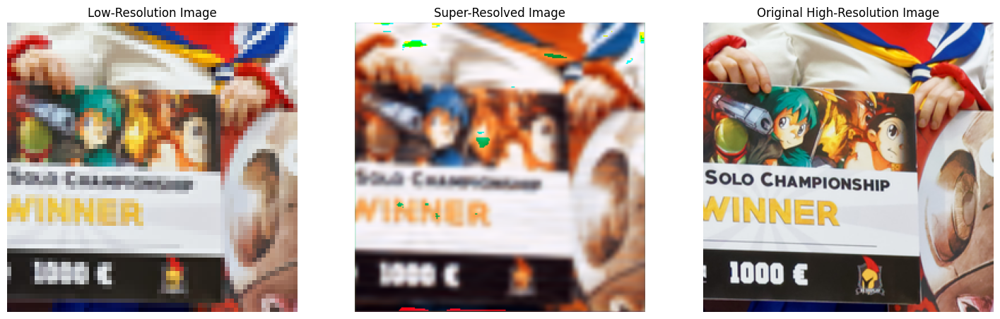

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


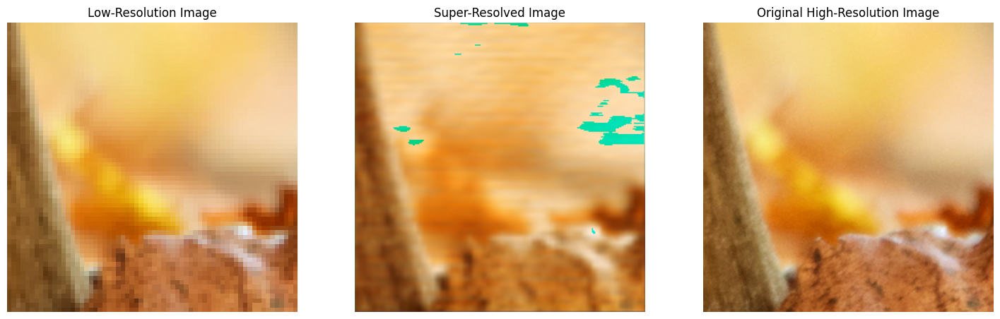

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


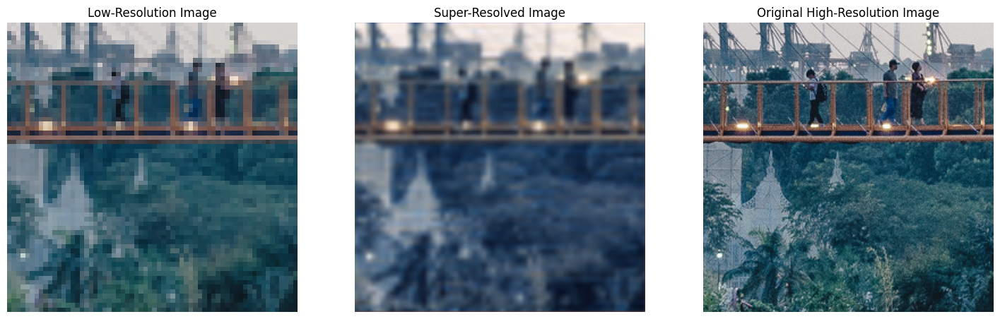

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


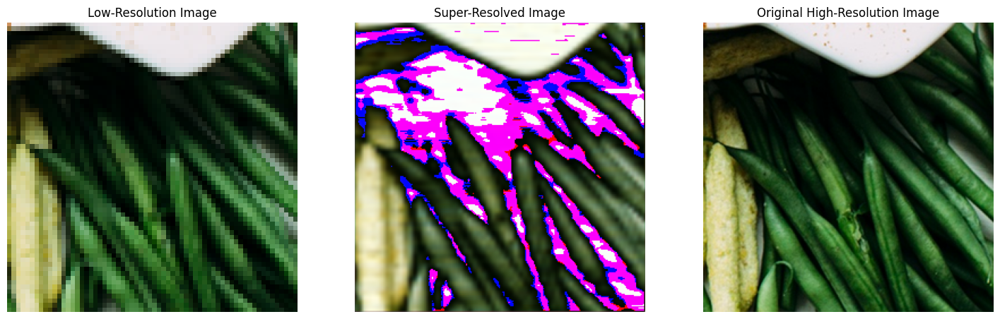

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


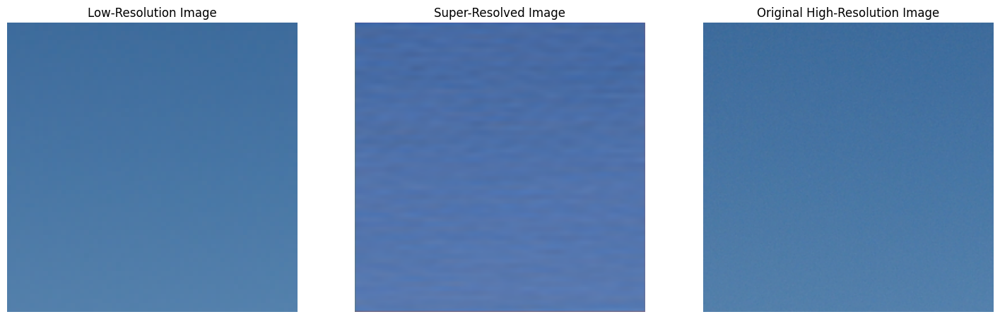

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


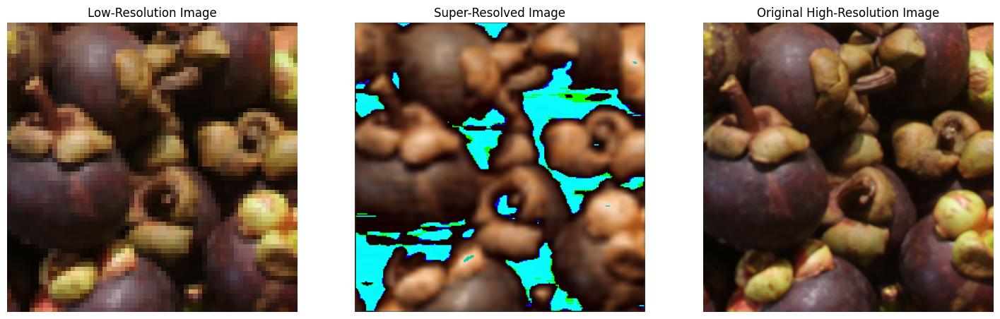

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


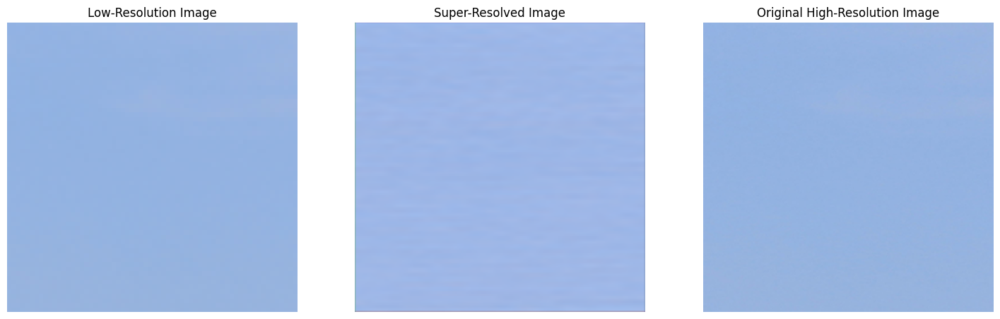

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


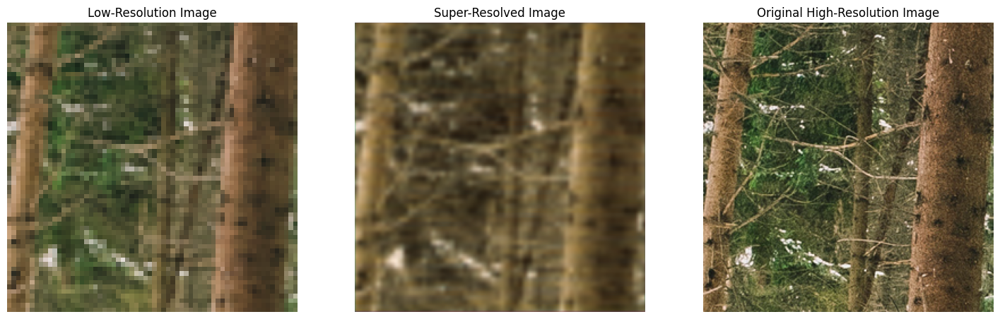

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


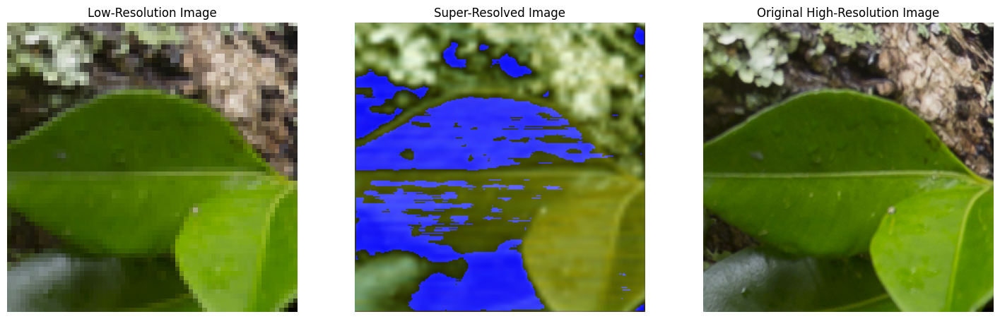

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


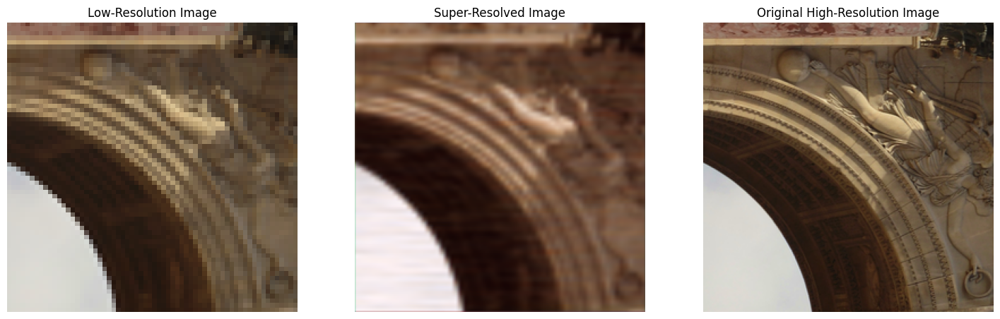

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


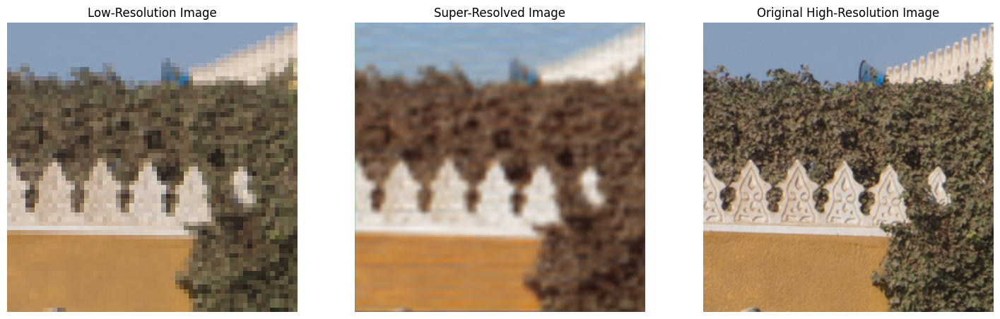

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


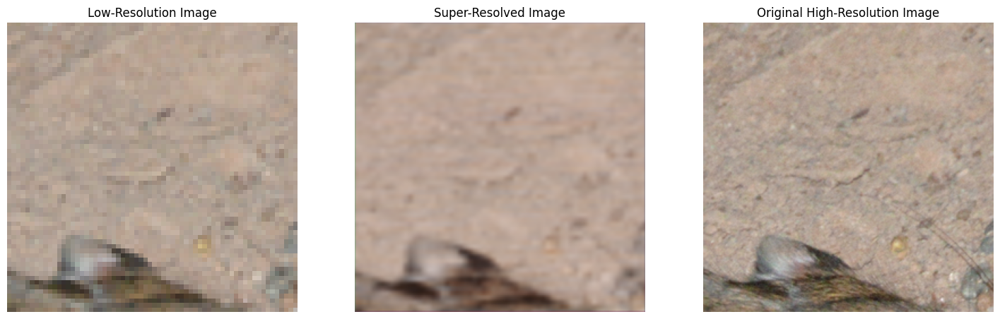

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


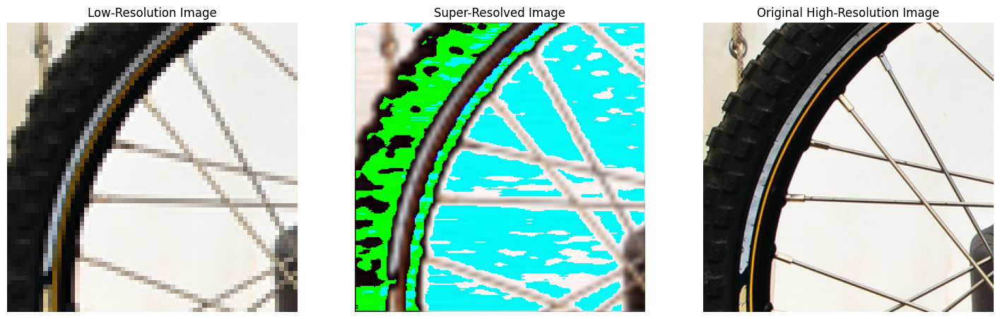

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


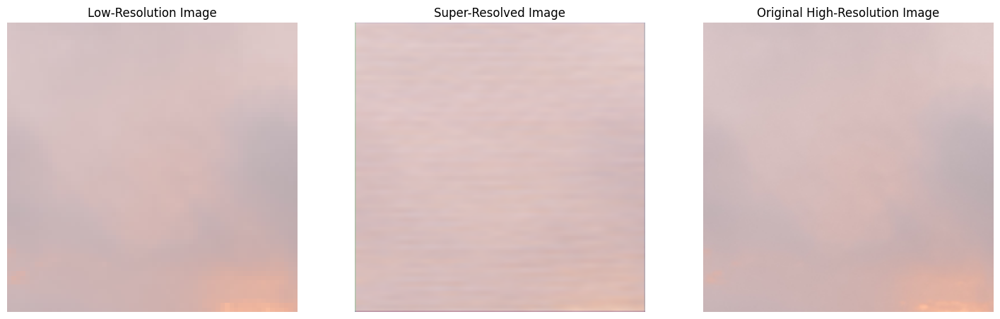

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


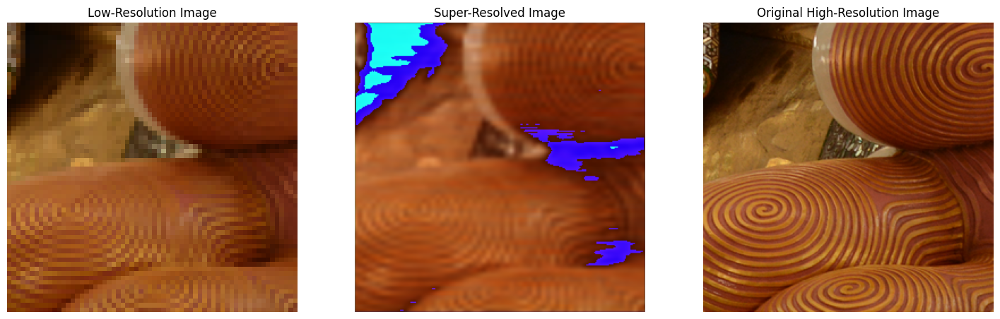

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


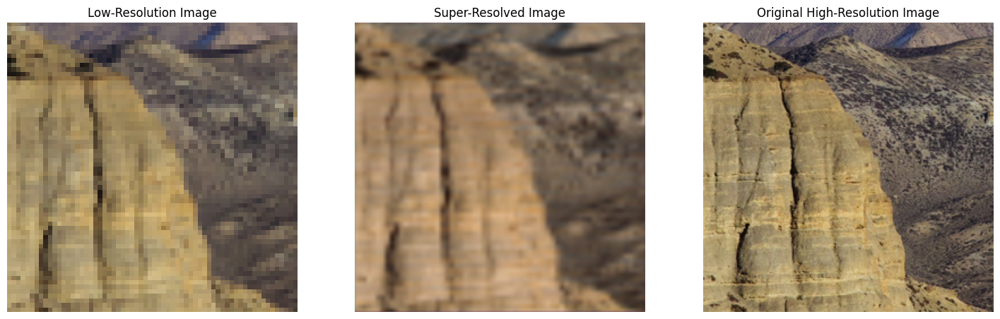

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


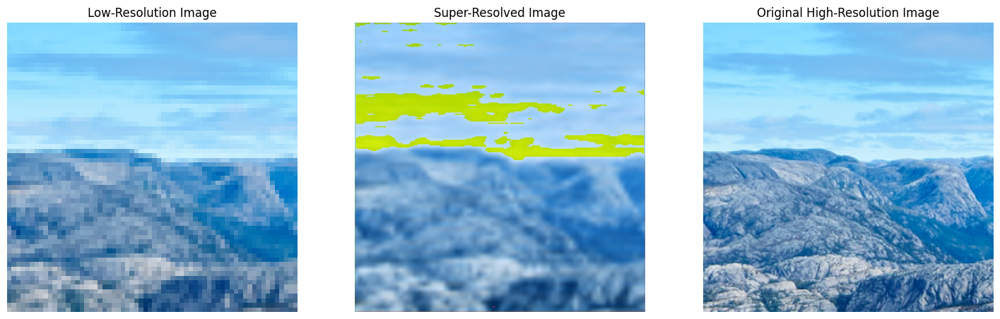

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


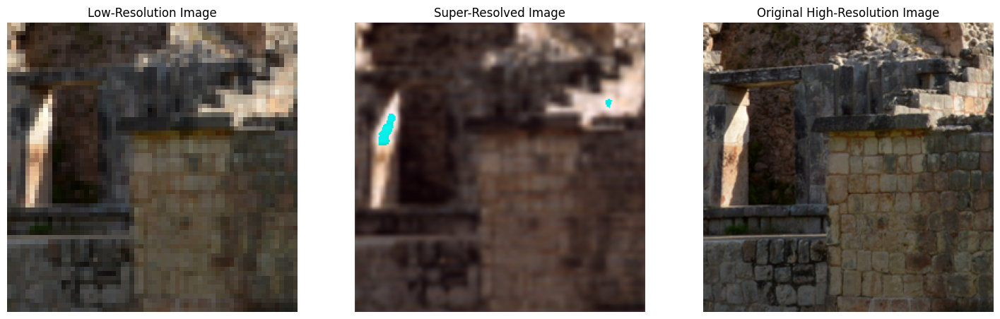

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


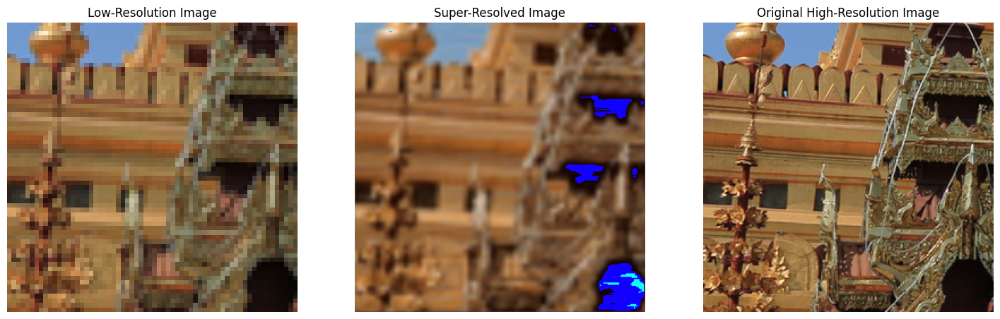

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


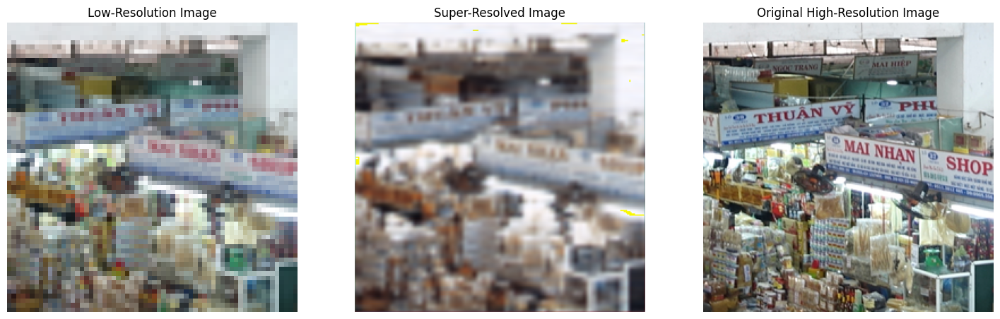

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


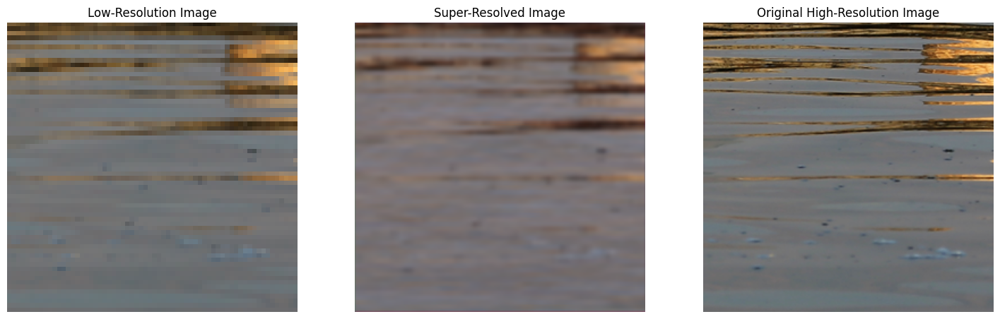

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


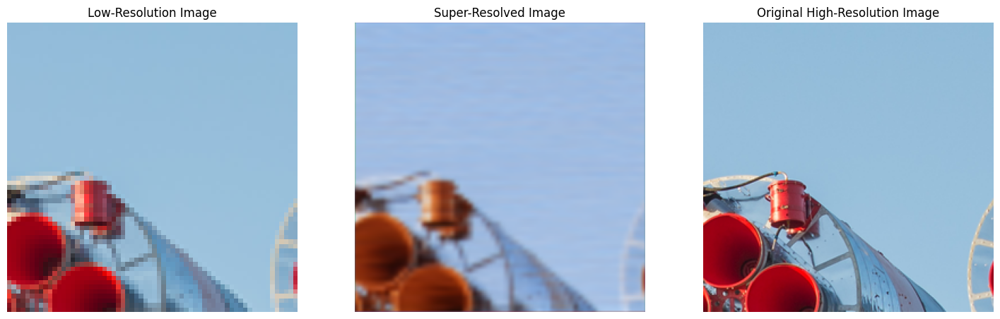

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


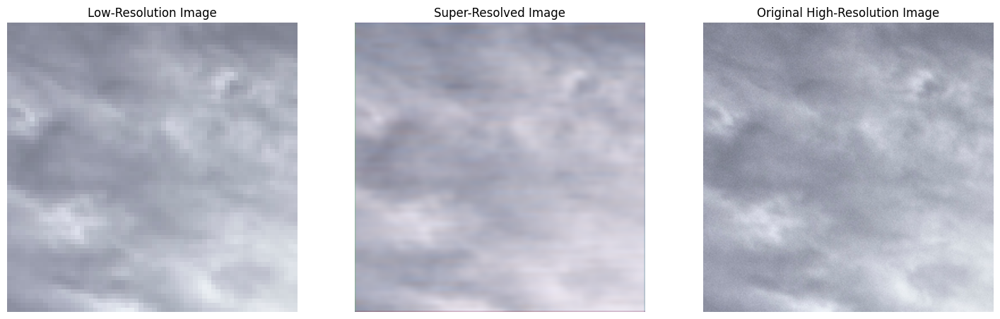

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


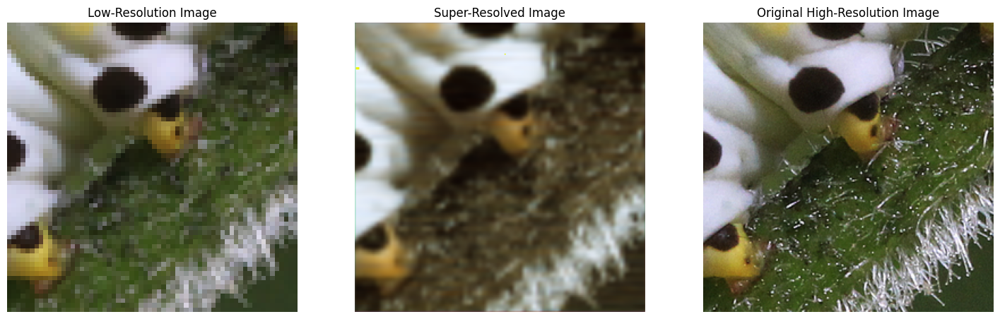

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


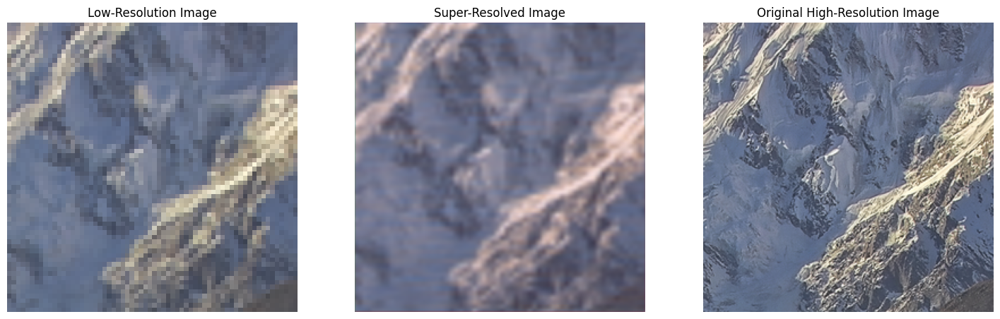

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


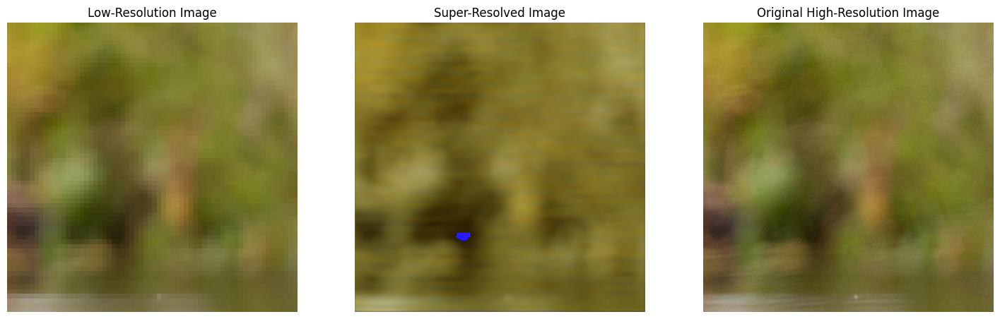

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


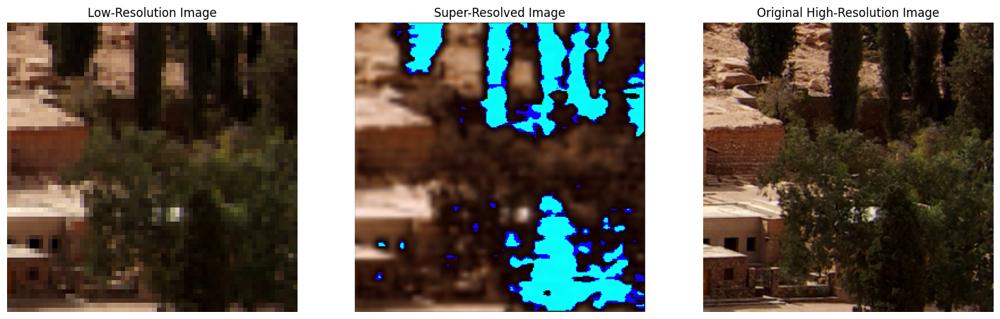

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


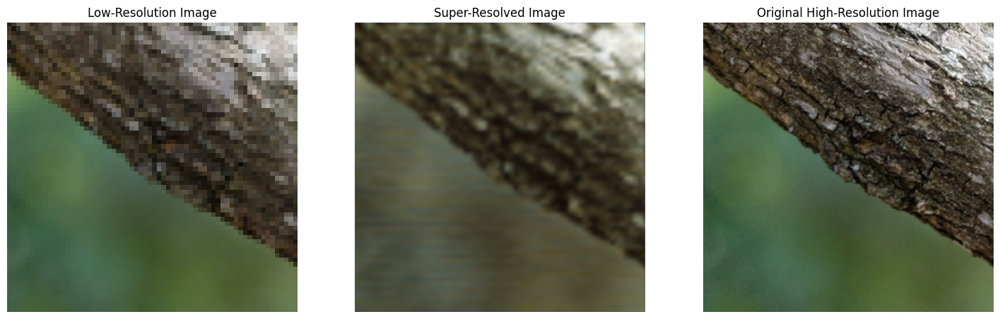

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


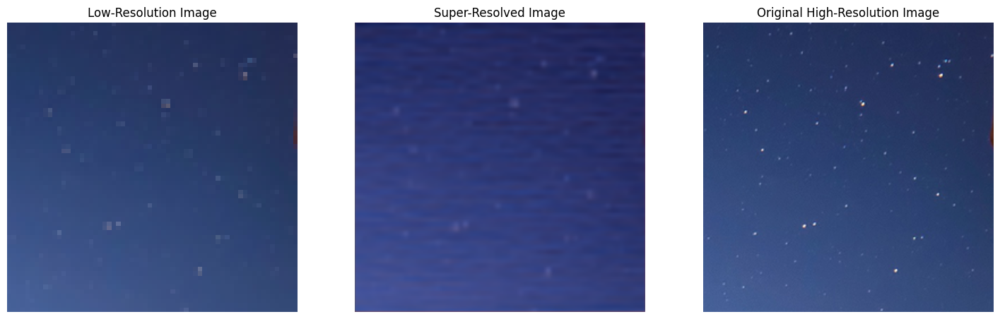

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


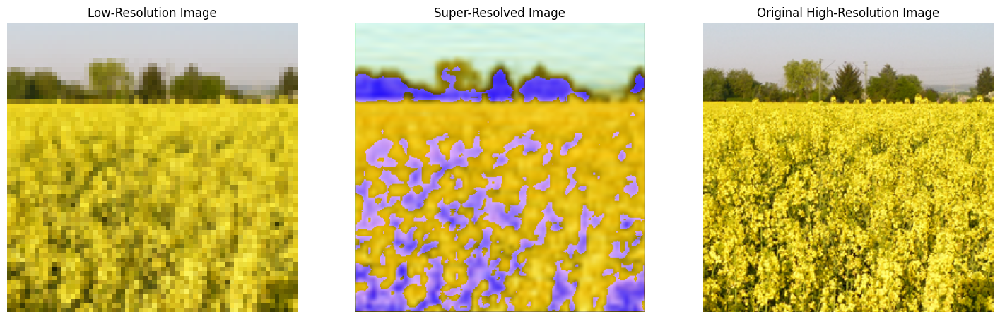

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


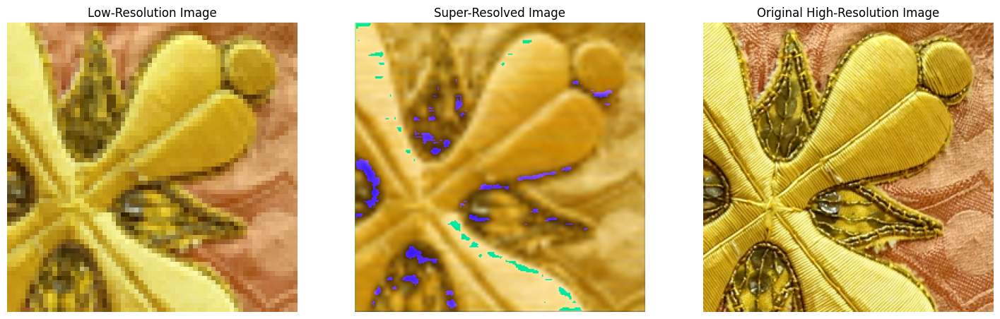

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


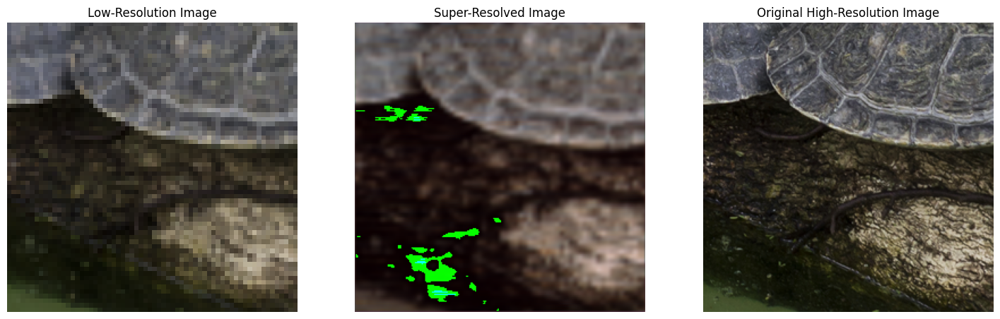

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


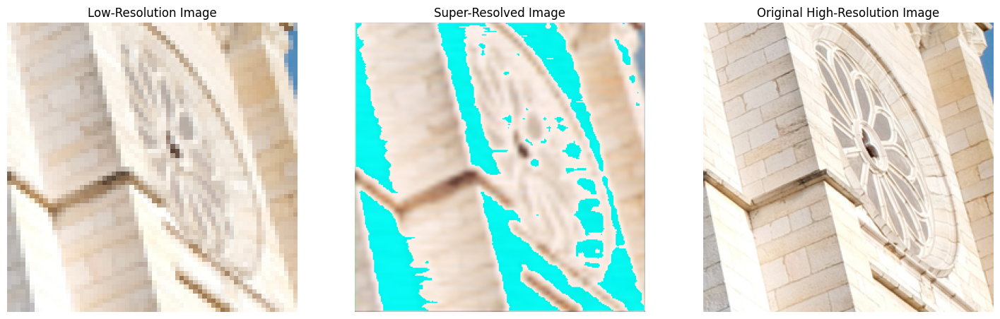

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


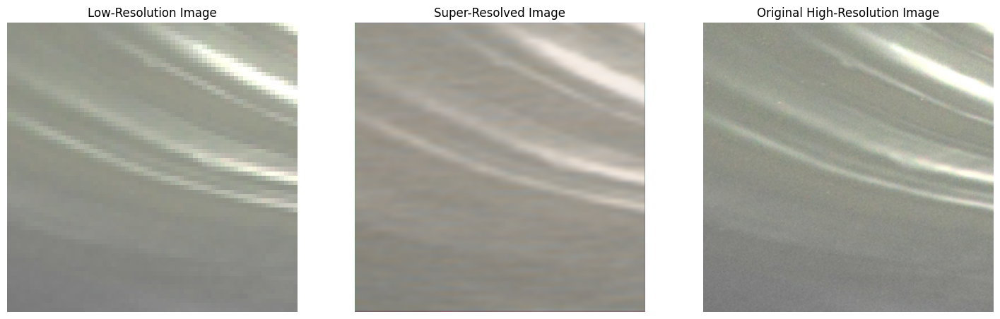

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


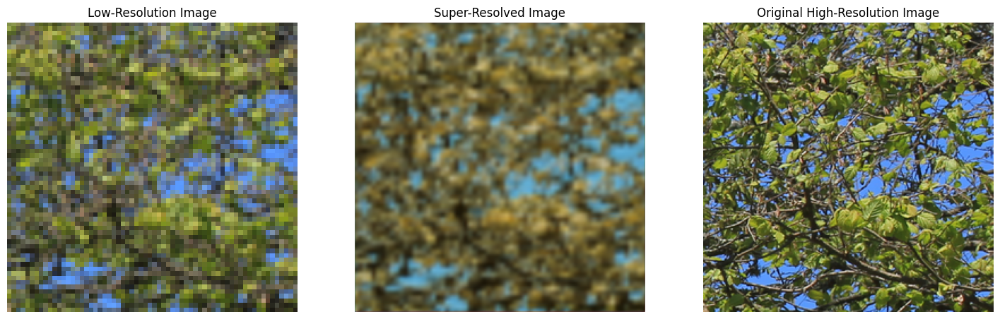

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


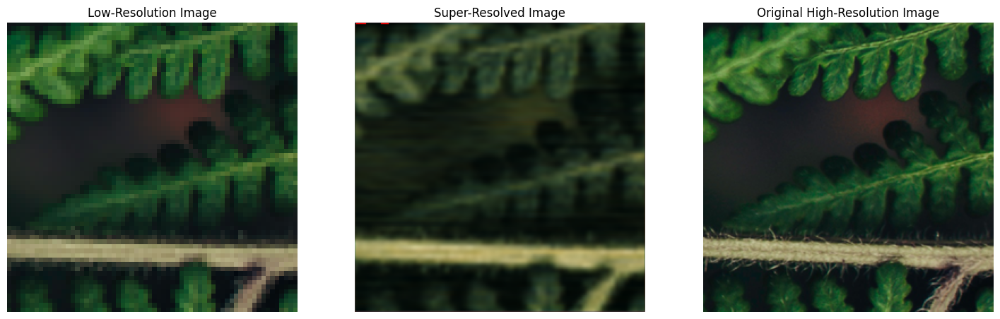

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


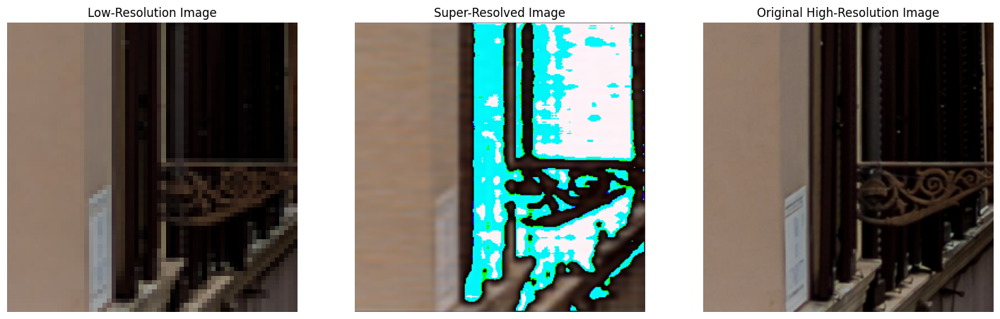

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


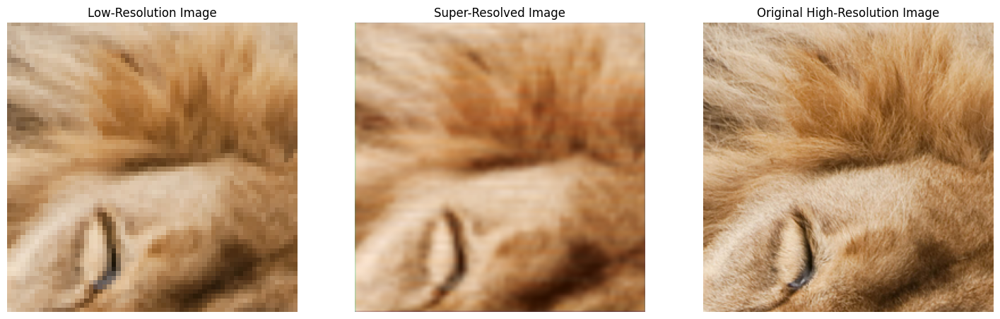

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


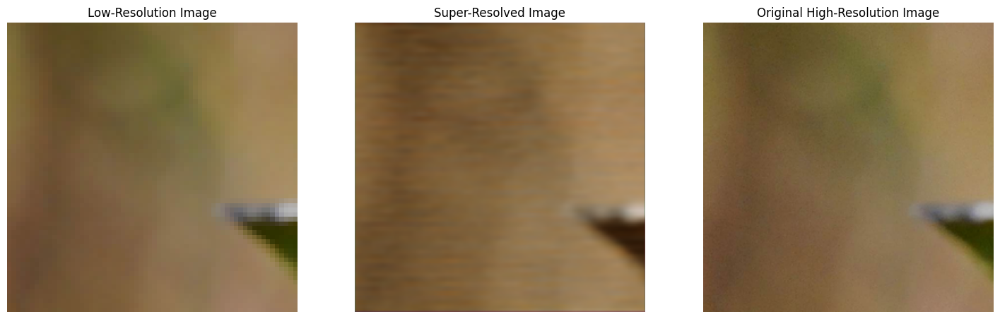

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


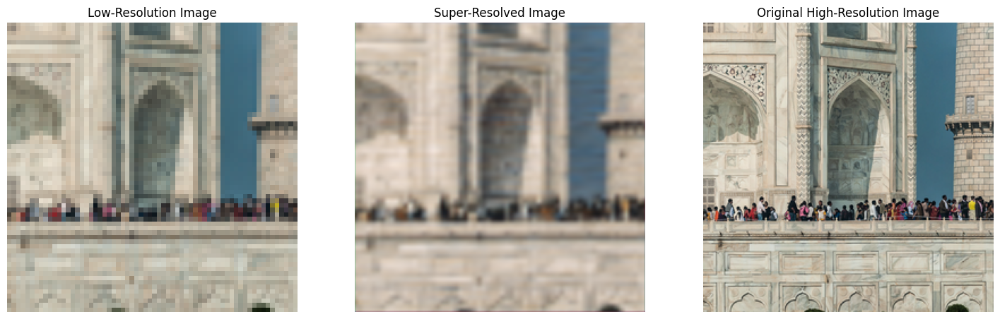

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


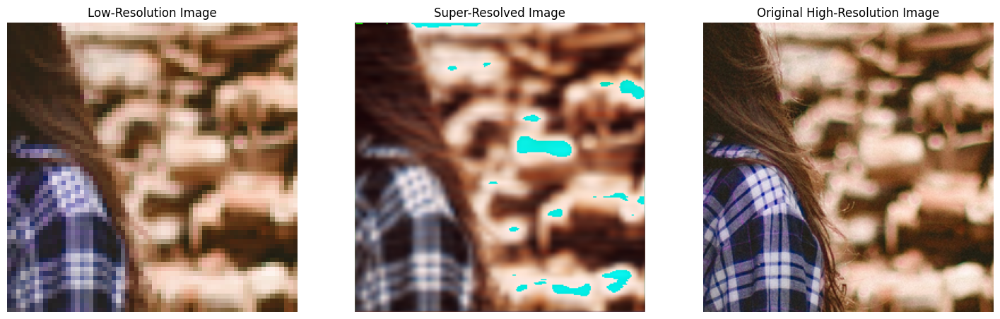

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


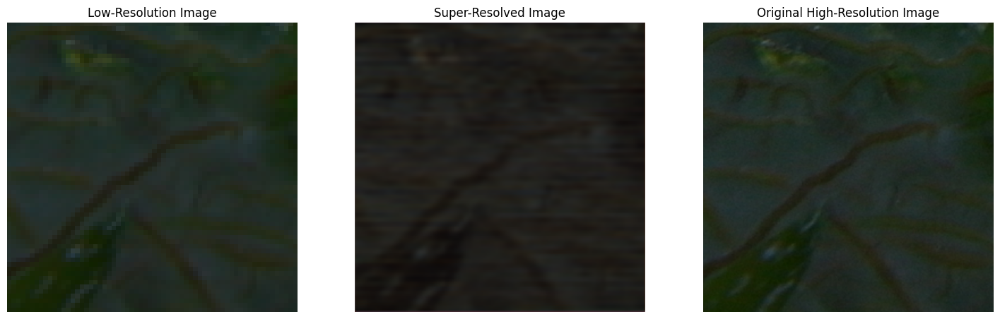

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


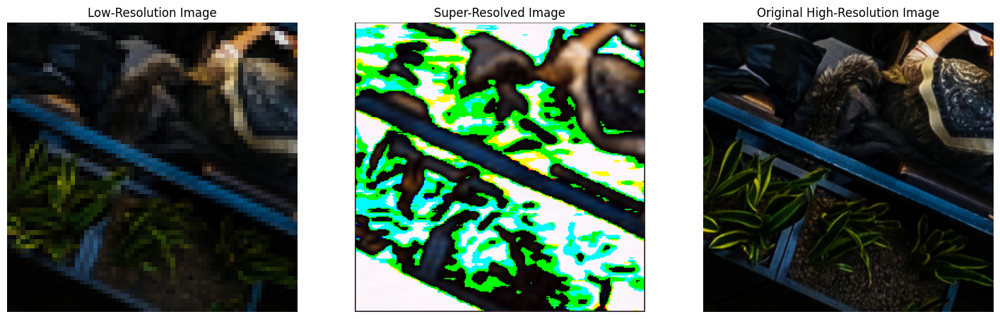

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


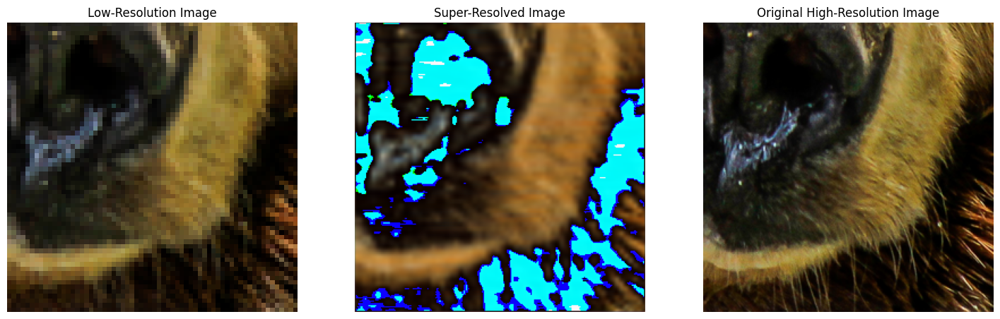

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


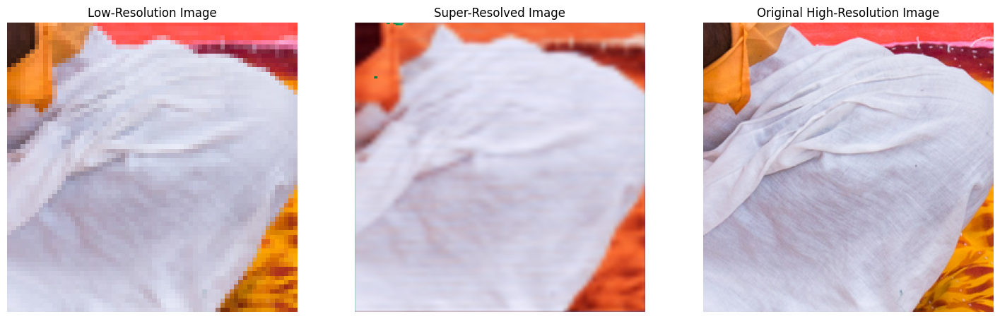

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


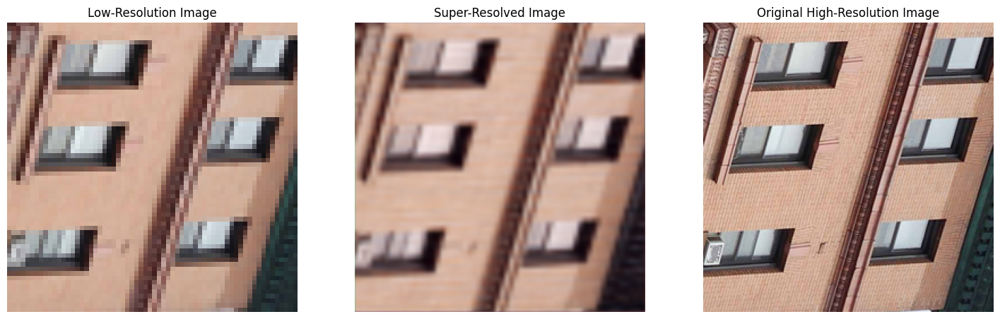

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


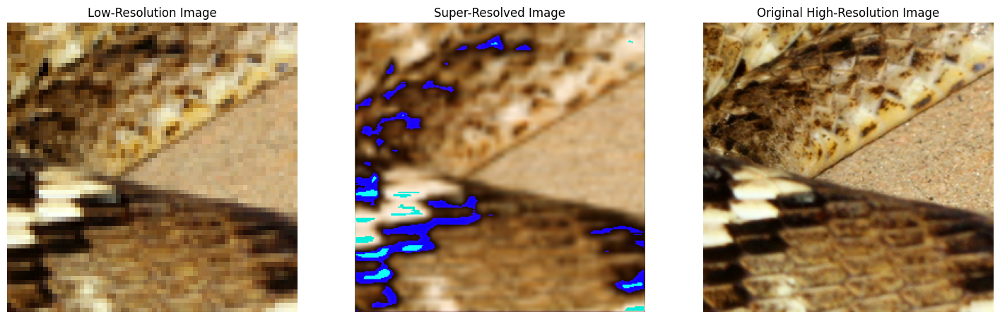

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


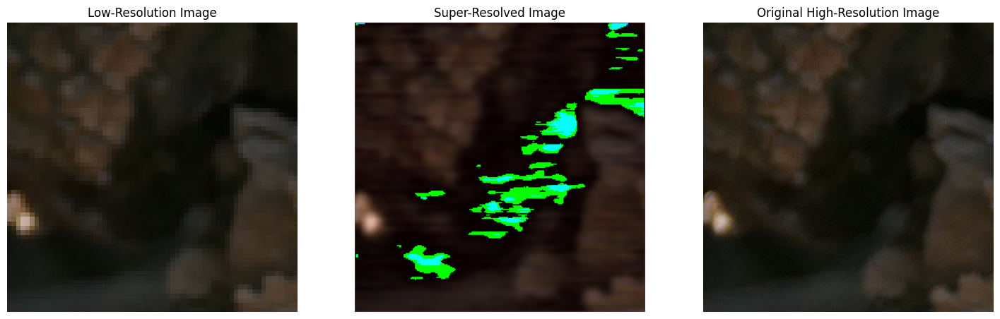

In [ ]:
def display_comparison(model, test_loader, device='mps', num_images=3):
    # Set the model to evaluation mode
    model.eval()

    # Define an inverse transform to undo normalization
    inverse_transform = T.Compose([
        T.Normalize(mean=[-0.5 / 0.5, -0.5 / 0.5, -0.5 / 0.5], std=[1 / 0.5, 1 / 0.5, 1 / 0.5]),
        T.ToPILImage()
    ])

    # Process the first few images from the test loader
    with torch.no_grad():
        for i, (lr_imgs, hr_imgs) in enumerate(test_loader):
            if i >= num_images:
                break

            # Move images to the appropriate device
            lr_imgs, hr_imgs = lr_imgs.to(device), hr_imgs.to(device)

            # Generate the super-resolved image using the model
            sr_imgs = model(lr_imgs)

            # Loop through the batch
            for j in range(lr_imgs.size(0)):
                # Get the images
                lr_image = lr_imgs[j].cpu()
                sr_image = sr_imgs[j].cpu()
                hr_image = hr_imgs[j].cpu()

                # Undo normalization and convert back to PIL
                lr_image_pil = inverse_transform(lr_image)
                sr_image_pil = inverse_transform(sr_image)
                hr_image_pil = inverse_transform(hr_image)
                print(f'The size of the High-res id: {hr_image_pil.size}')
                print(f'The size of the Trained-res id: {sr_image_pil.size}')
                print(f'The size of the Low-res id: {lr_image_pil.size}')
                # Display the images side by side
                plt.figure(figsize=(18, 6))

                plt.subplot(1, 3, 1)
                plt.title('Low-Resolution Image')
                plt.imshow(lr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.title('Super-Resolved Image')
                plt.imshow(sr_image_pil)
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.title('Original High-Resolution Image')
                plt.imshow(hr_image_pil)
                plt.axis('off')

                plt.show()

# Example usage:
display_comparison(model, test_loader, device=device, num_images=3)

### **$L_{1}, α=2$**    


In [ ]:
model_alpha2 = TransformerEncoderDecoder(img_dim=64)
checkpoint_path = '/content/gdrive/My Drive/Colab Notebooks/checkpoints/transformer_sr_enc_dec_MAE_epoch_16_val_loss_0.2103.pth'
model_alpha2.load_state_dict(torch.load(checkpoint_path))

# Step 3: Move the model to the device
model_alpha2 = model_alpha2.to(device)
evaluate_model_with_mssim(model_alpha2, test_loader, device=device)

<ipython-input-45-a4524cb96e48>:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model_alpha2.load_state_dict(torch.load(checkpoint_path))


Average PSNR: 16.2991 dB
Average SSIM: 0.7293
Average MSSIM: 0.7739


(16.299078396388463, 0.7292524831635612, tensor(0.7739, device='cuda:0'))

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


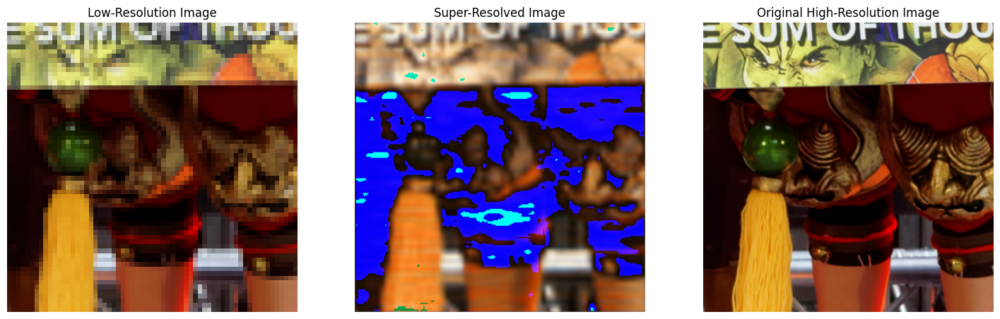

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


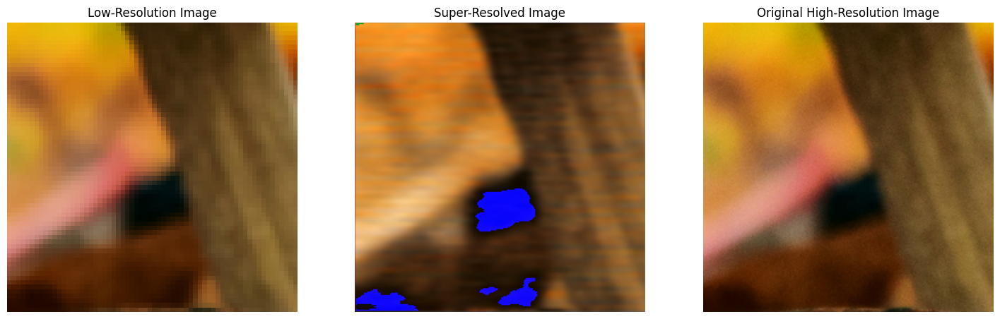

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


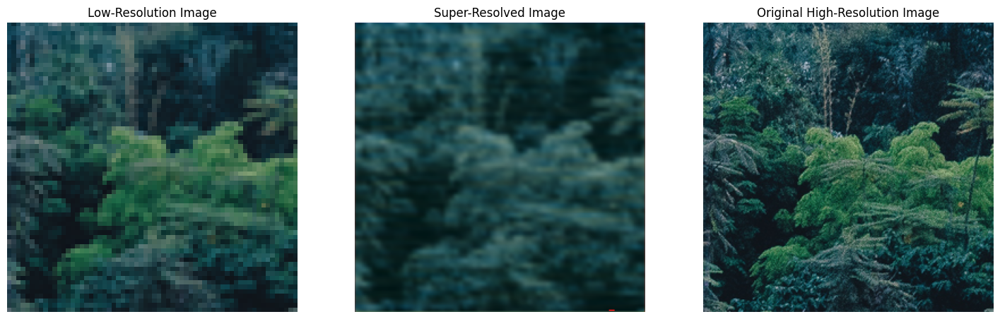

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


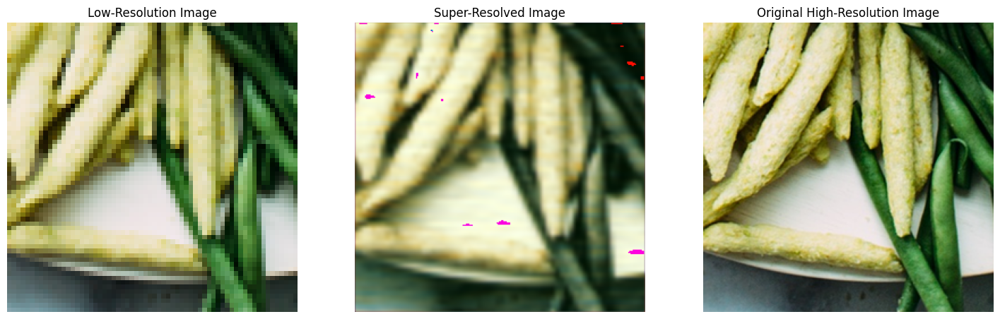

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


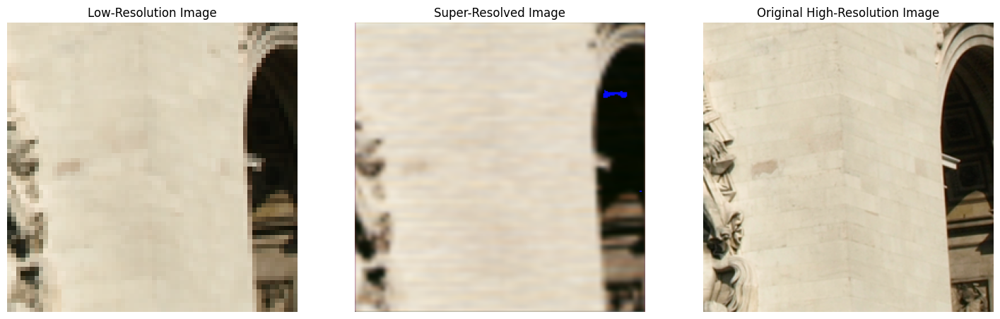

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


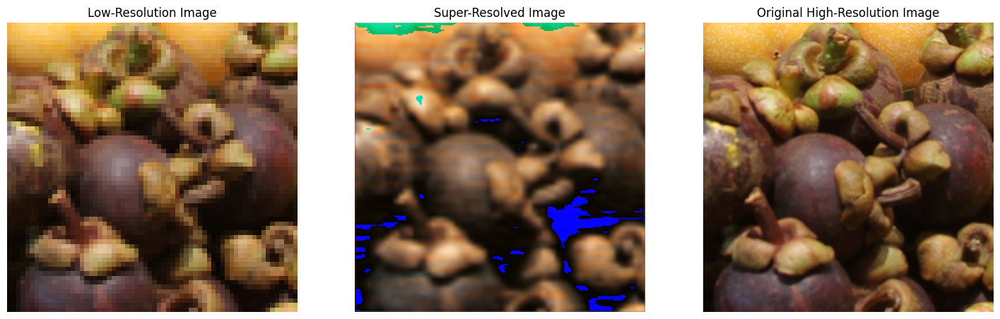

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


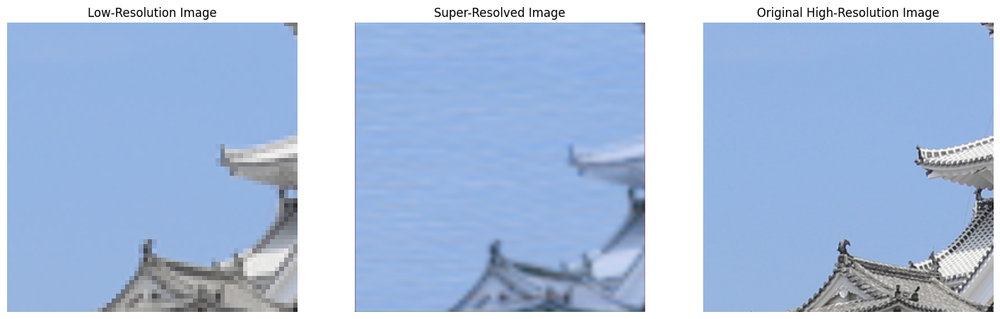

The size of the High-res id: (256, 256)
The size of the Trained-res id: (256, 256)
The size of the Low-res id: (64, 64)


In [ ]:
display_comparison(model_alpha2, test_loader, device=device, num_images=3)